# Text Preprocessing for Sentiment analysis

In [ ]:
import tensorflow as tf                 ### models
import numpy as np                  ### math computations
import matplotlib.pyplot as plt                 ### plotting bar chart
import sklearn              ### machine learning library
import cv2                    ## image processing
from sklearn.metrics import confusion_matrix, roc_curve       ### metrics
import seaborn as sns         ### visualizations
import datetime
import pathlib
import io
import os
import re     # regular expression module
import string
import time
from numpy import random
# import gensim.downloader as api
from PIL import Image
import tensorflow_datasets as tfds
import tensorflow_probability as tfp
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Layer
from tensorflow.keras.layers import (Dense,Flatten,SimpleRNN,InputLayer,Conv1D,Bidirectional,GRU,LSTM,BatchNormalization,Dropout,Input, Embedding,TextVectorization)
from tensorflow.keras.losses import BinaryCrossentropy,CategoricalCrossentropy, SparseCategoricalCrossentropy
from tensorflow.keras.metrics import Accuracy,TopKCategoricalAccuracy, CategoricalAccuracy, SparseCategoricalAccuracy
from tensorflow.keras.optimizers import Adam
from google.colab import drive
from google.colab import files
from tensorboard.plugins import projector

In [ ]:
batch_size = 64

In [ ]:
train_data, val_data, test_data = tfds.load(
    name="imdb_reviews",
    split=('train', 'test[:50%]', 'test[50%:]'),
    as_supervised=True)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating train examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/imdb_reviews/plain_text/incomplete.2GO79V_1.0.0/imdb_reviews-train.tfrecor…

Generating test examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/imdb_reviews/plain_text/incomplete.2GO79V_1.0.0/imdb_reviews-test.tfrecord…

Generating unsupervised examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/imdb_reviews/plain_text/incomplete.2GO79V_1.0.0/imdb_reviews-unsupervised.…

Dataset imdb_reviews downloaded and prepared to /root/tensorflow_datasets/imdb_reviews/plain_text/1.0.0. Subsequent calls will reuse this data.


In [ ]:
train_data

<_PrefetchDataset element_spec=(TensorSpec(shape=(), dtype=tf.string, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

In [ ]:
for text_batch, label_batch in train_data.take(5):
  print(f'Review: {text_batch.numpy()}')
  print(f'Label: {label_batch.numpy()}')

Review: b"This was an absolutely terrible movie. Don't be lured in by Christopher Walken or Michael Ironside. Both are great actors, but this must simply be their worst role in history. Even their great acting could not redeem this movie's ridiculous storyline. This movie is an early nineties US propaganda piece. The most pathetic scenes were those when the Columbian rebels were making their cases for revolutions. Maria Conchita Alonso appeared phony, and her pseudo-love affair with Walken was nothing but a pathetic emotional plug in a movie that was devoid of any real meaning. I am disappointed that there are movies like this, ruining actor's like Christopher Walken's good name. I could barely sit through it."
Label: 0
Review: b'I have been known to fall asleep during films, but this is usually due to a combination of things including, really tired, being warm and comfortable on the sette and having just eaten a lot. However on this occasion I fell asleep because the film was rubbish.

## Standardization of Text input using [tensorflow](https://www.tensorflow.org/api_docs/python/tf/strings)
- **`lowercase`** - so a word (say in and In or IN) don't represent differently in vocabulary we will built from the corpus/data.
- **`Remove html tags`** like `<br /><br` (if present) as they don't contain imp information. (use [tf.regex_replace()](https://www.tensorflow.org/api_docs/python/tf/strings/regex_replace)).
- Remove **Punctuation** marks (its use depends on your project problem so don't use blindly.)
- Remove special characters.
- Remove accented characters.
- **`Stemming`** - reduces words to their base form (like discussion, discussed, discussing ----> discuss) this reduces the size of vocabulary (`PorterStemmer` from `nltk`).
  - it doesn't work for some words like try with **`tensed`**, it will convert to **`tens`**, a word making no sense.
- **`Lemmatization`** - Addresses the limitation of stemming and do in-depth analysis and outputs a lemma similar to STEM/actual word (Preferable but still depends on your problem).

In [ ]:
def standardization(input_data):
    '''
    Input: raw reviews
    output: standardized reviews
    '''
    lowercase = tf.strings.lower(input_data)
    no_tag = tf.strings.regex_replace(lowercase,"<[^>]+>","")
    output = tf.strings.regex_replace(no_tag,"[%s]"%re.escape(string.punctuation),"")

    return output

In [ ]:
standardization(tf.constant("<u>In the movie?, </u>man called Tévèz, went to a friend’s pl**ce and they had a tensed discussion. I don’t love this movie! would you?<br> <br /><br />T"))

<tf.Tensor: shape=(), dtype=string, numpy=b'in the movie man called t\xc3\xa9v\xc3\xa8z went to a friend\xe2\x80\x99s plce and they had a tensed discussion i don\xe2\x80\x99t love this movie would you t'>

In [ ]:
from nltk.stem.porter import PorterStemmer
PorterStemmer().stem('tensed')

'tens'

## Tokenization
1. **`Character Tokenization`** - Converts Each character/alphabet to token (i.e. This boy---> T, h, i, s, b, o, y...), then these tokens are converted to corresponding id/number in vocabulary.
2. **`Word Tokenization`** - Each word is considered as token (i.e. This boy---> This, boy...), then these tokens are converted to corresponding id/number in vocabulary.
3. **`Sub-Word Tokenization`** - b/w character and word tekenization, it divides word into sub words like `'actor' to 'act' and 'or'` or `'actar' to 'act' and 'ar'.` So it gives some context to model to understand
4. **`n-gram Tokenization`** - n number of successive words are taken as token `i.e. I love this actor`. for `2-gram` tokenization, `first 2 words` (**I love**) will be a `token` then next 2 (**love this**) and then next 2 (**this actor**) and so on.

Any `word` that is `not in the vocabulary` is `considered as unknown` word. **`Consider`** we have a `vocabulary of 1000 words`. Then following sentence with word tokenization will have iDs as follows
```python
This actor played her role very well.
235   19    617    71 27   82    199  ---IDs

```

Machine learning `model tends to consider order` of the words in a sentence (Self Attention/Multihead Attention Mecha.), they do get benefited from the fact that the word 'actor' comes before the word 'played', So these IDs are OneHot Encoded in which all other values or there relative positions are 0 except one i.e. The vector for 'This' will have all other values 0 except the position 235 (there is 1), and the total length of vector will be the same as vocabulary size (1000 here)

- The **`Advantage of Character level tokenization`** is that we have `smaller vocabulary` as compare to Word tokenization also in case of word tokenization, if we have a `mispelled word` (i.e. 'actar' instead of 'actor') the model will `consider` it `as Unknown` and this word will not be used by model in understanding the sentence.

## Numericalization
- A method to convert tokens to numbers.


### 1. **`OneHot`**
- Already Discussed above, here relative position of token in vocabulary is 1 and all others are 0. i.e. a Vocabulary of 1000 words with 'this' at 235th number, the 235th position in vector will contain 1 and all others will be 0.
```python
This actor played her role very well.
235   19    617    71 27   82    199  ---IDs

```

#### For a vocabulary of size 1000:
```python
**Word: "This" (ID = 235)**  
```
$
\text{OneHot}("This") =
\begin{bmatrix}
0 \\
0 \\
\cdot \\
\cdot \\
\cdot \\
1 \; \; (\text{at position 235}) \\
0 \\
\cdot \\
\cdot \\
\cdot \\
0
\end{bmatrix}_{1000 \times 1}
$

```python
**Word: "actor" (ID = 19)**  
```
$
\text{OneHot}("actor") =
\begin{bmatrix}
0 \\
\cdot \\
\cdot \\
1 \; \; (\text{at position 19}) \\
0 \\
\cdot \\
\cdot \\
0
\end{bmatrix}_{1000 \times 1}
$

```python
**Word: "played" (ID = 617)**  
```
$
\text{OneHot}("played") =
\begin{bmatrix}
0 \\
0 \\
\cdot \\
\cdot \\
\cdot \\
1 \; \; (\text{at position 617}) \\
0 \\
\cdot \\
\cdot \\
\cdot \\
0
\end{bmatrix}_{1000 \times 1}
$


```python
- These are joined to form a single matrix as follows
```
**Sentence/Query: "This actor played"**


$
\text{OneHot}(\text{sentence}) =
\begin{bmatrix}
0 & 0 & 0 \\
0 & \cdot & 0 \\
\cdot & \cdot & \cdot \\
\cdot & \cdot & \cdot \\
\cdot & 1\; \; (\text{pos 19}) & \cdot \\
1\; \; (\text{pos 235}) & 0 & \cdot \\
0 & 0 & \cdot \\
\cdot & \cdot & \cdot \\
\cdot & \cdot & \cdot \\
\cdot & \cdot & 1\; \; (\text{pos 617}) \\
0 & 0 & 0
\end{bmatrix}_{1000 \times 3}
$

```python
- Then we will Transpose the above 1000×3 matrix to 3×1000
  means it will have 3 different tokens with 1000 vectors each:
```
$
\text{OneHot(sentence)}^T =
\begin{bmatrix}
0 & 0 & \cdot & 1 & 0 & 0 & \cdot & 0 \\
0 & \cdot & 1 & 0 & 0 & 0 & \cdot & 0 \\
0 & 0 & 0 & 0 & 1 & 0 & \cdot & 0
\end{bmatrix}_{3 \times 1000}
$


### 2. **`Bag of Words (BoW)`**
The Bag of Words model is a simple way to represent text as numbers.
```python
- It `ignores grammar` and `word order`.
- It `only cares` about `which words appear` and `how many times` they appear.
- Think of it as a `“word count dictionary”` for each sentence or document.
```

**`Example with a toy vocabulary of size 10:`**

**Vocabulary:**  
```python
["this", "actor", "played", "her", "role", "very", "well", "movie", "was", "great"]`
```
**Sentence/Query:**  
```python
This actor played her role very well.`
```

**Word Counts:**
- Now count how many times each word from the vocabulary appears in the sentence:
```python
| Word   | Count |
|--------|-------|
| this   | 1     |
| actor  | 1     |
| played | 1     |
| her    | 1     |
| role   | 1     |
| very   | 1     |
| well   | 1     |
| movie  | 0     |
| was    | 0     |
| great  | 0     |
```

**Vector Representation:**
- $\text{BoW}("This actor played her role very well") =
[1, \; 1, \; 1, \; 1, \; 1, \; 1, \; 1, \; 0, \; 0, \; 0]$

```python

- **Dimension** = size of vocabulary (10 in this toy example).  
- Each entry = frequency of the corresponding word in the sentence.
- This representation is useful because the more a particular word appears in a sentence,
  the higher its value will be in the vector. As a result, two sentences/documents that share
  many words will have similar vectors and will be closer together in vector space.
- There is another variant **`Bag of n-grams`**, catches more information/context.
```

### 3. **`TF–IDF (Term Frequency – Inverse Document Frequency)`**
```python
**Problem with Bag of Words:**  
- All words are treated equally.  
- Common words like *"the"*, *"is"*, *"and"* appear frequently, but they don’t carry much meaning.  
- We want **important / unique words** to have **higher weight**.
```

#### Formula

- **TF (Term Frequency):** How often a word appears in a document  
$
TF(t, d) = \frac{\text{Number of times term } t \text{ appears in document } d}{\text{Total number of terms in document } d}
$


- **IDF (Inverse Document Frequency):** How important a word is (rarer words → higher value)

$
IDF(t) = \log \left( \frac{N}{1 + df(t)} \right)
$

where  
- $N$ = total number of documents  
- $df(t)$ = number of documents containing term $t$

- **TF–IDF weight:**  
$
TF\text{-}IDF(t,d) = TF(t,d) \times IDF(t)
$

**`For a sentence:`**

$
TF = \frac{\text{Number of times a word occurs in the sentence}}{\text{Total number of words in the sentence}}
$

$
IDF(t) = \log \left( \frac{\text{Number of sentences}}{\text{Number of sentences with the word}}\right)
$

#### **`Example`**

**Corpus (3 documents):**
```python
1. `This actor played well`  
2. `That actor played poorly`  
3. `The movie was great`

```

**Vocabulary (7 words):**

```python  
`["this", "that", "actor", "played", "well", "poorly", "movie"]`
```


**Step 1 – Term Frequency (TF):**
```python

| Word   | Doc1 | Doc2 | Doc3 |
|--------|------|------|------|
| this   | 1    | 0    | 0    |
| that   | 0    | 1    | 0    |
| actor  | 1    | 1    | 0    |
| played | 1    | 1    | 0    |
| well   | 1    | 0    | 0    |
| poorly | 0    | 1    | 0    |
| movie  | 0    | 0    | 1    |

```
**Step 2 – IDF values:**

$
IDF(t) = \log \left(\frac{N}{1 + df(t)}\right), \quad N = 3
$

```python
- actor → appears in 2 docs → log(3/3) = 0   
- played → appears in 2 docs → log(3/3) = 0   
- this → appears in 1 doc → log(3/2)   
- that → appears in 1 doc → log(3/2)  
- well → appears in 1 doc → log(3/2)  
- poorly → appears in 1 doc → log(3/2)  
- movie → appears in 1 doc → log(3/2)

```
So common words (*actor*, *played*) get weight **0**, while unique words get **positive weight**.

**Step 3 – TF–IDF weighted matrix:**
```python

| Word   | Doc1 | Doc2 | Doc3 |
|--------|------|------|------|
| this   | log(3/2) | 0         | 0         |
| that   | 0        | log(3/2)  | 0         |
| actor  | 0        | 0         | 0         |
| played | 0        | 0         | 0         |
| well   | log(3/2) | 0
```

### 4. **Embeddings**

So far (One-Hot, BoW, TF–IDF):
- High-dimensional (equal to vocabulary size, often tens of thousands).
  - i.e. for a 10 word sentence with model vocabulary of 10k, the dimension will be 10 by 10000.
- Sparse (mostly zeros).  
- Do not capture semantic meaning (e.g., *"king"* and *"queen"* are just different positions).
- In OneHot encoding every word have same distance.



#### **`Word Embeddings`**
- Word embeddings are **dense, low-dimensional vectors** (e.g., 50, 100, 300 dimensions).  
- `Learned from data (you don't have to pass embedding matrix yourself)`, so words with similar meanings are **close together in vector space**.  
- Example models: **`Word2Vec`**, **`GloVe`**, **`FastText`**.  


#### **`Example (2D toy embedding)`**

Suppose we map words into 2D space:
```python
Embedding("king") = [0.95,  0.80]
Embedding("queen") = [0.90, 0.78]
Embedding("apple") = [0.12, 0.99]
```

```python
- Here, "king"* and "queen" are closer together than "king" and "apple".  
- Unlike one-hot, embeddings capture **semantic similarity**.  
```

- **One-Hot** → unique ID only, no meaning.  
- **Embeddings** → learned representation, captures relationships like:  
```python
Vector("king") - Vector("man") + Vector("woman") ≈ Vector("queen")
```



#### **`Converting Sparse Matrix to Embedding`**

- Suppose we have a **sentence with 4 words**.  
- Vocabulary size = **10,000**.  
- Each word is represented by a **One-Hot vector** of size `1 × 10000`.  

So the sentence forms a matrix:  
```python
(4 × 10000) (4 words, each with 10k-dimensional sparse vector)
```
#### `Embedding Transformation`

- We introduce an **Embedding Matrix** of size (this may contain any number):

```python
(10000 × 300) (vocab size × embedding dimension)
```

- Multiplying them:  

```python
(4 × 10000) × (10000 × 300) = (4 × 300)
```


#### Result
```python
- Output = **dense representation** of the sentence.  
- Each of the 4 words is now represented by a **300-dimensional dense vector** instead of a sparse 10,000-dimensional one.  
```
This is the `essence of word embeddings`: **compressing sparse, high-dimensional data into meaningful, low-dimensional dense vectors.**

# How RNN Works
- Regular neural networks (MLPs, CNNs) treat inputs **independently**.  
- But text, speech, time series have **sequential nature** (context matters).  
- Example:  
  - "He is going to the **bank**" → could mean *riverbank* or *financial bank*, depends on **previous words**.  


### **`Core Idea of RNN`**
- RNNs introduce a **hidden state** that is passed from one time step to the next.  
- This allows the model to "remember" information about **previous inputs**.  


### **`Flow of Computation`**

For a sequence of words (after embedding):  
$
x_1, x_2, x_3, \dots, x_T
$

At each time step ($t$):

1. Input word embedding: $x_t$  
2. Previous hidden state: $h_{t-1}$  
3. Update hidden state:  
$
h_t = \tanh(W_{xh} \cdot x_t + W_{hh} \cdot h_{t-1} + b_h)
$
4. Output (optional at each step):  
$
y_t = W_{hy} \cdot h_t + b_y
$


### **`Visualization`**
$x_1 → [RNN cell] → h_1 → y_1$\
↑\
$x_2 → [RNN cell] → h_2 → y_2$\
↑\
$x_3 → [RNN cell] → h_3 → y_3$\
↑\
...
```python
- The **arrow going up** represents the hidden state being passed forward.  
- The same RNN cell (weights) is reused at every time step.  

- **Weights are shared** across all time steps (unlike feedforward networks).  
- The hidden state \(h_t\) acts as the "memory".  
- RNNs can, in theory, handle sequences of any length.  
- **Problem:** In practice, they struggle with **long-term dependencies** due to
  vanishing/exploding gradients → solved later with **LSTM** and **GRU**.
- In short:  RNN = Neural network with a "memory" that processes data step by step.
```

## Bidirectional RNNs (Bi-RNNs)

### **`Problem with Basic RNNs`**
- The hidden state \(h_t\) in a standard RNN only captures **past information** (previous time steps).  
- It cannot consider **future context**.  

**Example:**
```python
Sentence: *"The concert was so bad, I loved it!"*  
- The word **"bad"** is actually modified by *"I loved it!"* (future context).  
- A vanilla RNN would miss this relationship.
```

### **`Solution: Bidirectional RNN`**
- A **Bi-RNN** processes the sequence in **both directions**:
  - **Forward RNN**: from left → right  
  - **Backward RNN**: from right → left  
- At each time step $(t)$, we get **two hidden states**:
  - Forward hidden state: $( \overrightarrow{h_t})$  
  - Backward hidden state: $( \overleftarrow{h_t})$  

The final hidden representation at time $(t)$ is a **combination** (e.g., concatenation):  
$
h_t = [\overrightarrow{h_t}; \overleftarrow{h_t}]
$

### **`Flow of Computation`**

1. **Forward Pass**  
   - For each time step $(t)$:  
   $
   \overrightarrow{h_t} = \tanh(W_{xh}^{(f)} x_t + W_{hh}^{(f)} \overrightarrow{h_{t-1}} + b_h^{(f)})
   $  

2. **Backward Pass**  
   - For each time step $(t)$:  
   $
   \overleftarrow{h_t} = \tanh(W_{xh}^{(b)} x_t + W_{hh}^{(b)} \overleftarrow{h_{t+1}} + b_h^{(b)})
   $  

3. **Combination**  
   - The output at each time step is based on both directions:  
   $
   y_t = W_h \cdot [\overrightarrow{h_t}; \overleftarrow{h_t}] + b_y
   $  

### **`Visualization`**
- Forward RNN: $x1 → h1(f) → h2(f) → h3(f) → ...$
- Backward RNN: $... ← h3(b) ← h2(b) ← h1(b) ← x1$
- Combined: $h_t = [h_t(f); h_t(b)]$

```python
- Bi-RNNs capture **both past and future dependencies**.  
- Very useful in:
  - **Text classification**
  - **Sentiment analysis**
  - **Named Entity Recognition (NER)**
- Downside:  
  - Cannot be used for **real-time predictions** like in streaming (you do not know what
    comes next), since future context is required.  
```

### **`Toy Example`**
- `Sentence:` **"I love NLP"**  
- `Vocabulary` → { "I", "love", "NLP" }  

| Time step | Word  | Forward hidden $(\overrightarrow{h_t}$) | Backward hidden $(\overleftarrow{h_t})$ | Combined representation $(h_t)$ |
|-----------|-------|--------------------------------------------|--------------------------------------------|---------------------------------|
| t=1       | I     | depends on "I"                            | depends on "I, love, NLP" (future context) | concat([fwd, bwd])              |
| t=2       | love  | depends on "I, love"                      | depends on "love, NLP"                     | concat([fwd, bwd])              |
| t=3       | NLP   | depends on "I, love, NLP"                 | depends on "NLP"                           | concat([fwd, bwd])              |

```python
So at **t=2 ("love")**, the representation includes:
- Past context: "I" (from forward pass)  
- Future context: "NLP" (from backward pass)  
```

$
h_2 = [\overrightarrow{h_2}; \overleftarrow{h_2}]
$

### **`Visualization`**
- Forward RNN: I → love → NLP
- Backward RNN: I ← love ← NLP
- Combined at each step: $h_t = [forward; backward]$

# Data Preparation

## Vectorization
- Tokenization and Numericalization of text is done under single block of tensorflow named [TextVectorization](https://www.tensorflow.org/api_docs/python/tf/keras/layers/TextVectorization).

In [ ]:
vocab_size = 10000  # it specifies the number of most important words, here we want to take first 10000 most imp words
sequence_length = 250 # In order to get this we can use the below function and then take the mean/median of 'lengths'
embedding_dim = 300

In [ ]:
from tensorflow.keras.layers import TextVectorization

vectorization = TextVectorization(
    standardize = standardization,
    max_tokens = vocab_size,
    output_mode='int',    # outputs the index numbers or indices of the words in the vocabulary.
    output_sequence_length = sequence_length    # ensures that the output has same length as Neural nets require inputs of same length, if smaller input it adds padding of 0, if larger then it truncates it to sequence length.
)


## Function to Guess values for Vocab. size and Sequence Length
- `train_ds.take(100)` → takes the first 100 examples (`reviews + labels`) from your training dataset (`train_ds`).
- Each `review` is a **text string**, and `label` is likely **0 or 1** (e.g., sentiment).
- `tf.strings.split(review, sep=" ")` → splits each review into a list of words (tokens) by spaces.
- `len(tf.strings.split(review, sep=" "))` → counts how many words (tokens) are in that review.
- `lengths.append(...)` → **saves the word count** of each review into the lengths list.
- After the loop, lengths will contain the distribution of review lengths for the first 100 samples.

In [ ]:
lengths=[]
words=[]

for review,label in train_data.take(10):

  # Following builds a vocabulary list of unique words
  for word in tf.strings.split(review, sep=" "):
    if word in words:     # if word already in words list then pass, if not then append it.
      pass
    else:
      words.append(word)
  lengths.append(len(tf.strings.split(review, sep=" ")))    # Gets sequence length
print(len(words))
print(lengths)

913
[116, 112, 132, 88, 81, 289, 557, 111, 223, 127]


## Create a Vocabulary
- we have to get the library of unique words, but for that we have to separate our `review` data from `labels` and then apply `TextVectorization`.

The vocabulary is built from our dataset.
- `Index 0` → reserved for padding.
- `Index 1` → reserved for unknown words (UNK) (i.e., words not found in top 10,000).
- `Index 2 onward` → actual words from your dataset (sorted by frequency)

In [ ]:
training_data = train_data.map(lambda review, label:review)    ### input x(review) and y(label) and output x(review)
vectorization.adapt(training_data)      #### adapt the vectorization layer to the training data

In [ ]:
vectorization.get_vocabulary()

['',
 '[UNK]',
 np.str_('the'),
 np.str_('and'),
 np.str_('a'),
 np.str_('of'),
 np.str_('to'),
 np.str_('is'),
 np.str_('in'),
 np.str_('it'),
 np.str_('this'),
 np.str_('i'),
 np.str_('that'),
 np.str_('was'),
 np.str_('as'),
 np.str_('with'),
 np.str_('for'),
 np.str_('movie'),
 np.str_('but'),
 np.str_('film'),
 np.str_('on'),
 np.str_('not'),
 np.str_('are'),
 np.str_('you'),
 np.str_('his'),
 np.str_('have'),
 np.str_('be'),
 np.str_('he'),
 np.str_('one'),
 np.str_('its'),
 np.str_('at'),
 np.str_('all'),
 np.str_('by'),
 np.str_('an'),
 np.str_('they'),
 np.str_('who'),
 np.str_('from'),
 np.str_('like'),
 np.str_('so'),
 np.str_('her'),
 np.str_('or'),
 np.str_('just'),
 np.str_('about'),
 np.str_('has'),
 np.str_('out'),
 np.str_('if'),
 np.str_('some'),
 np.str_('what'),
 np.str_('there'),
 np.str_('good'),
 np.str_('more'),
 np.str_('very'),
 np.str_('when'),
 np.str_('she'),
 np.str_('even'),
 np.str_('up'),
 np.str_('no'),
 np.str_('would'),
 np.str_('my'),
 np.str_('whic

In [ ]:
len(vectorization.get_vocabulary())

10000

## Vectorization Continues

In [ ]:
for text_batch, label_batch in train_data.take(1):
  print(f'Review: {text_batch.numpy()}')    # Converts the TensorFlow tensor into a NumPy array (so it can be printed/read easily).
  print(f'Label: {label_batch.numpy()}')

Review: b"This was an absolutely terrible movie. Don't be lured in by Christopher Walken or Michael Ironside. Both are great actors, but this must simply be their worst role in history. Even their great acting could not redeem this movie's ridiculous storyline. This movie is an early nineties US propaganda piece. The most pathetic scenes were those when the Columbian rebels were making their cases for revolutions. Maria Conchita Alonso appeared phony, and her pseudo-love affair with Walken was nothing but a pathetic emotional plug in a movie that was devoid of any real meaning. I am disappointed that there are movies like this, ruining actor's like Christopher Walken's good name. I could barely sit through it."
Label: 0


In [ ]:
# To convert sequence/raw text/review to Numbers, pass it to the adapted vectorization layer
def vectorizer(review,label):
    return vectorization(review),label

In [ ]:
train_dataset = train_data.map(vectorizer)
val_dataset = val_data.map(vectorizer)

- Each number (below cell's output) = index of a word in the vocabulary.
- `Example:` 10 → "this", 13 → "was", etc.
- 1 → `UNK` (unknown word).
- 0 → `padding` (added so that every sequence is exactly 200 words long, as set by sequence_length=200).

In [ ]:
for text_batch, label_batch in train_dataset.take(1):
  print(f'Review: {text_batch.numpy()}')
  print(f'Label: {label_batch.numpy()}')
  print(f'Shape: {text_batch.shape}')

Review: [  10   13   33  411  384   17   89   26    1    8   32 1337 3521   40
  491    1  192   22   84  149   18   10  215  317   26   64  239  212
    8  484   54   64   84  111   95   21 5502   10   91  637  737   10
   17    7   33  393 9554  169 2443  406    2   87 1205  135   65  142
   52    2    1 7408   65  245   64 2832   16    1 2851    1    1 1415
 4969    3   39    1 1567   15 3521   13  156   18    4 1205  881 7874
    8    4   17   12   13 4037    5   98  145 1234   11  236  696   12
   48   22   91   37   10 7285  149   37 1337    1   49  396   11   95
 1148  841  140    9    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    

In [ ]:
'''
Review: b"This was an absolutely terrible movie. Don't be lured in by Christopher Walken or Michael Ironside. Both are great actors, but this must simply be their worst role in history. Even their great acting could not redeem this movie's ridiculous storyline.
This movie is an early nineties US propaganda piece. The most pathetic scenes were those when the Columbian rebels were making their cases for revolutions. Maria Conchita Alonso appeared phony, and her pseudo-love affair with Walken was nothing but a pathetic
emotional plug in a movie that was devoid of any real meaning. I am disappointed that there are movies like this, ruining actor's like Christopher Walken's good name. I could barely sit through it."
Label: 0
'''
vectorization.get_vocabulary()[10]    # insert the above digits to see the word, 0 represent padding, remember we did use sequence_length = 250, if our sequence is not equals to 200, then it will add 0's as padding and 1 represents Unknown (UNK) word, not present in our vocabulary of top 10,000 words.

np.str_('this')

In [ ]:
batch_size = 64

train_dataset = train_dataset.batch(batch_size).prefetch(buffer_size=tf.data.AUTOTUNE)
val_dataset = val_dataset.batch(batch_size).prefetch(buffer_size=tf.data.AUTOTUNE)

# Simple [RNN in Tensorflow](https://www.tensorflow.org/api_docs/python/tf/keras/layers/SimpleRNN)

In [ ]:
inputs=np.random.random([32, 10, 8]).astype(np.float32)     # [32, 10, 8] ---->[Batch_size, Sequence_length, Vocabulary_size], 10 inputs each with 8 dimensional vector (same as vocab size)

# input should be [batch_size, seq_len, Vocab_size] if OneHot encoded or [batch_size, seq_len] if integer representation of data is passed

simple_rnn=tf.keras.layers.SimpleRNN(25, return_sequences = False)    # most of the arguments are default except units (here 25) in RNN, activation = tanh deals with vanishing gradients prob here
                                            # return_sequences=True/False, whether to return output of all RNN blocks separately or the output of last RNN in sequence, set to True if working with multilayer RNN
output=simple_rnn(inputs)
print(output.shape)

(32, 25)


In [ ]:
embedding_dim = 64
model=tf.keras.models.Sequential([
    Input(shape=(sequence_length,)),      # shape is 1D, see below the vectorizer cell (250, )

    Embedding(vocab_size,embedding_dim),    # dimension of Embedding vector is V by E means vocab_size by embedding dim, incoming input is mapped or multiplied to this vector to transform it

    SimpleRNN(32),    # with 32 RNN units/blocks/cells, with return_sequences = False, outputting the output of the only last RNN cell

    Dense(1,activation='sigmoid'),    # output is 0 or 1\Negative or Positive so we used sigmoid
])
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding (Embedding)           │ (None, 250, 64)        │       640,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_1 (SimpleRNN)        │ (None, 32)             │         3,104 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 643,137 (2.45 MB)

 Trainable params: 643,137 (2.45 MB)

 Non-trainable params: 0 (0.00 B)

## Model Checkpoint + Training

In [ ]:
checkpoint_filepath = '/content/drive/MyDrive/nlp/sentiment_analysis/rnn.h5'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

In [ ]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(1e-4),
              metrics=['accuracy'])

In [ ]:
history=model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=10,
    callbacks=[model_checkpoint_callback])

Epoch 1/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - accuracy: 0.5010 - loss: 0.6955

391/391 ━━━━━━━━━━━━━━━━━━━━ 20s 43ms/step - accuracy: 0.5010 - loss: 0.6955 - val_accuracy: 0.4968 - val_loss: 0.6940
Epoch 2/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - accuracy: 0.5270 - loss: 0.6874 - val_accuracy: 0.4965 - val_loss: 0.6937
Epoch 3/10
390/391 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - accuracy: 0.5767 - loss: 0.6720

391/391 ━━━━━━━━━━━━━━━━━━━━ 11s 29ms/step - accuracy: 0.5768 - loss: 0.6720 - val_accuracy: 0.5269 - val_loss: 0.6930
Epoch 4/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 10s 26ms/step - accuracy: 0.5508 - loss: 0.6726 - val_accuracy: 0.5066 - val_loss: 0.6965
Epoch 5/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.6283 - loss: 0.6351

391/391 ━━━━━━━━━━━━━━━━━━━━ 25s 37ms/step - accuracy: 0.6284 - loss: 0.6350 - val_accuracy: 0.6677 - val_loss: 0.6419
Epoch 6/10
389/391 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.7872 - loss: 0.5264

391/391 ━━━━━━━━━━━━━━━━━━━━ 15s 37ms/step - accuracy: 0.7874 - loss: 0.5262 - val_accuracy: 0.7698 - val_loss: 0.5320
Epoch 7/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 0.8529 - loss: 0.4061

391/391 ━━━━━━━━━━━━━━━━━━━━ 20s 37ms/step - accuracy: 0.8529 - loss: 0.4061 - val_accuracy: 0.7775 - val_loss: 0.5124
Epoch 8/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.8879 - loss: 0.3282

391/391 ━━━━━━━━━━━━━━━━━━━━ 14s 37ms/step - accuracy: 0.8879 - loss: 0.3281 - val_accuracy: 0.7866 - val_loss: 0.5071
Epoch 9/10
390/391 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 0.9035 - loss: 0.2859

391/391 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - accuracy: 0.9036 - loss: 0.2858 - val_accuracy: 0.8071 - val_loss: 0.4913
Epoch 10/10
389/391 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.9162 - loss: 0.2537

391/391 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - accuracy: 0.9163 - loss: 0.2535 - val_accuracy: 0.8142 - val_loss: 0.4562


## Plots

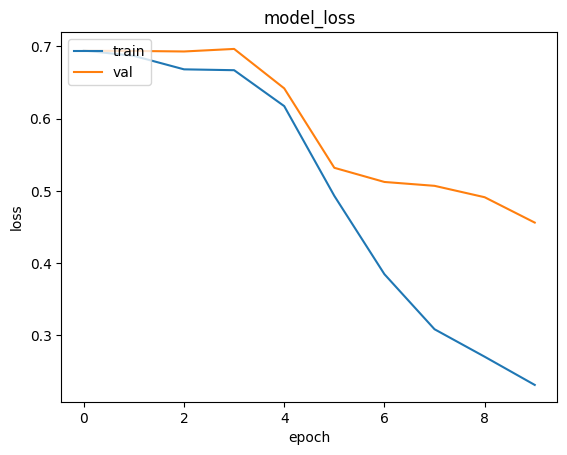

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model_loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

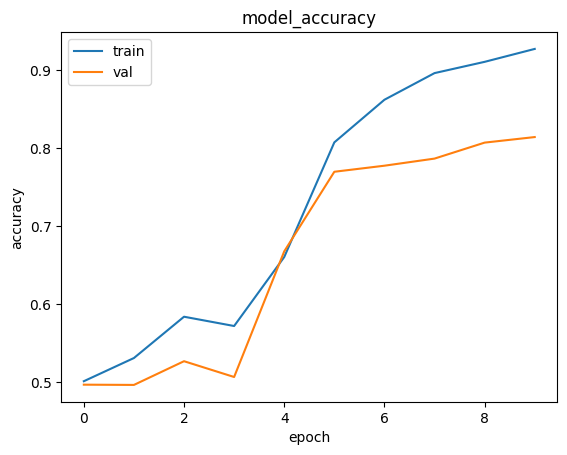

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])

plt.title('model_accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

## Evaluation

In [ ]:
test_dataset=test_data.map(vectorizer)
test_dataset=test_dataset.batch(batch_size)
model.evaluate(train_dataset)

391/391 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9188 - loss: 0.2464


[0.24207714200019836, 0.9205999970436096]

## Limitations of RNN
- it performs poorly sometimes, due to vanishing gradient problem and  Short term memory (because of very long input sequences about 250 in our case).
- Even if exploding/vanishing gradients don’t occur, plain RNNs tend to forget information from far back in the sequence.
### Strategies to Alleviate
- **`Gradient Clipping`**
- **`Activation Functions`**
  - Using tanh or sigmoid is more stable than ReLU inside recurrent cells (ReLU would blow up since it’s unbounded).
- **`Better Architectures`**
  - The main solution to vanishing gradients and short-term memory is using:
    - **LSTM** (Long Short-Term Memory)
    - **GRU** (Gated Recurrent Unit)
    - These add gates (input, forget, output) that help preserve information over longer sequences.
    - `Forget gate (sigmoid function)` controls the flow of information from one cell to other, if want to stop information it multiplies the information with 0 and want to pass it on, multiplies the info with 1. we can even add how much info we want to lose, for 70, pass 0.7, otherwise let sigmoid handle it.
- **`Other tricks`**
  - Layer normalization ($ \frac{X - \mu}{std} $ ) batch normalization in RNNs
  - Residual connections
  - Using Transformer models instead of RNNs (very common today).$\frac{5}{10} \cdot [6, 8]$

### **`Gradient Descent Update Rule`**
Normally, parameters update like this:

$$
W \leftarrow W - \eta \frac{\partial L}{\partial W}
$$

* $W$ → model parameter
* $\eta$ → learning rate
* $\frac{\partial L}{\partial W}$ → gradient of the loss wrt $W$


### **`Problem: Exploding Gradients`**

* In RNNs, during backpropagation through time, gradients can become **very large**.
* If the gradient is huge, parameter updates blow up → unstable training.

### **`Solution: Gradient Clipping`**
- We put a threshold $\tau$ (say 0.1 or 1.0).
Two common ways:

#### 1. **`Clipping by Value`**
- If each gradient component exceeds a threshold, replace it with the threshold.

$$
g_i \leftarrow
\begin{cases}
+\tau & \text{if } g_i > \tau \\
-\tau & \text{if } g_i < -\tau \\
g_i & \text{otherwise}
\end{cases}
$$

- So if your computed gradient is $2.5$ and $\tau=0.1$, it is replaced with $0.1$.

#### 2. **`Clipping by Norm (more common)`**
- We check the **L2 norm** of the gradient vector $g$.

$$
\| g \|_2 = \sqrt{\sum_i g_i^2}
$$

* If $\| g \|_2 \leq \tau$: keep gradient as is.
* If $\| g \|_2 > \tau$: rescale it:

$$
g \leftarrow \frac{\tau}{\| g \|_2}  g
$$
- This way, direction stays the same, but magnitude is reduced to the threshold.

### **`Example (Clipping by Norm)`**
`Suppose:`

$$
g = [3, 4], \quad \tau = 5
$$

* Norm: $\|g\|_2 = \sqrt{3^2 + 4^2} = 5$ → already okay, no change.

`If instead:`

$$
g = [6, 8], \quad \tau = 5
$$

* Norm: $\sqrt{6^2 + 8^2} = 10$ → too large.
* Rescale:

$$
g = \frac{5}{10} \cdot [6, 8] = [3, 4]
$$
- Now the gradient is safe.
### **`Updated Weight Rule with Clipping`**

$$
W \leftarrow W - \eta  g_{\text{clipped}}
$$

- Where $g_{\text{clipped}}$ is obtained by either **value clipping** or **norm clipping**.
- So in simple words:
  * If $gradient > threshold (say 0.1)$, bring it down to threshold.
  * This ensures gradients **don’t explode**, keeping updates stable.

# **[LSTM](https://www.tensorflow.org/api_docs/python/tf/keras/layers/LSTM) `(MultiLayer and Bidirectional)`**

- Vanilla RNNs suffer from:
  - **Vanishing gradients** → cannot learn long-term dependencies.
  - **Exploding gradients** → unstable training.
- They have **short-term memory**, so very long sequences (e.g., 200+ tokens) are hard to handle.


## **`Solution: LSTM (Long Short-Term Memory)`**

### 1. LSTM Idea
- Adds **gates** to control information flow:
  1. **Forget Gate ($f_t$)** → decides what past info to forget.
  2. **Input Gate ($i_t$)** → decides what new info to store.
  3. **Output Gate ($o_t$)** → decides what info to output.
- Maintains a **cell state $C_t$** that can carry information across long sequences.


### **`2. LSTM Formulas`**

`Forget Gate:`
$$
f_t = \sigma(W_f \cdot [h_{t-1}, x_t] + b_f)
$$

`Input Gate:`
$$
i_t = \sigma(W_i \cdot [h_{t-1}, x_t] + b_i)
$$

`Candidate Memory:`
$$
\tilde{C}_t = \tanh(W_C \cdot [h_{t-1}, x_t] + b_C)
$$

`Update Cell State:`
$$
C_t = f_t \odot C_{t-1} + i_t \odot \tilde{C}_t
$$

`Output Gate & Hidden State:`
$$
o_t = \sigma(W_o \cdot [h_{t-1}, x_t] + b_o)
$$

$$
h_t = o_t \odot \tanh(C_t)
$$

* $\sigma$ → sigmoid function (0 to 1)  
* $\odot$ → element-wise multiplication  

## **`GRU (Gated Recurrent Unit)`**

- Simplified version of LSTM:
  - Combines **forget and input gates** into **update gate $z_t$**  
  - No separate cell state; uses hidden state $h_t$ directly  
- Fewer parameters → faster to train, still captures long-term dependencies.


### **`GRU Formulas`**

`Update Gate:`
$$
z_t = \sigma(W_z \cdot [h_{t-1}, x_t])
$$

`Reset Gate:`
$$
r_t = \sigma(W_r \cdot [h_{t-1}, x_t])
$$

`Candidate Hidden State:`
$$
\tilde{h}_t = \tanh(W_h \cdot [r_t \odot h_{t-1}, x_t])
$$

`Final Hidden State:`
$$
h_t = (1 - z_t) \odot h_{t-1} + z_t \odot \tilde{h}_t
$$

```python
- LSTM/GRU **mitigate vanishing gradient problem** by maintaining a
  cell state / controlled memory flow.  
- GRU is lighter than LSTM (fewer gates) but often performs similarly.  
- Use **gradient clipping** in combination for stable training.  
- Both are **standard in NLP tasks** (sentiment analysis,
  translation, NER, etc.).
```


In [ ]:
embedding_dim = 64

model=tf.keras.models.Sequential([
    Input(shape=(sequence_length,)),
    Embedding(vocab_size,embedding_dim),

    Bidirectional(LSTM(64,return_sequences=True)),    # return_sequences=True, as we have 2 layered network so we want to pass all the outputs of the 1st layer to the 2nd layer
    Bidirectional(LSTM(32)),      # 2nd layer

    Dense(64, activation='relu'),
    Dropout(0.5),
    Dense(1,activation='sigmoid'),
])
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_1 (Embedding)         │ (None, 250, 64)        │       640,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional (Bidirectional)   │ (None, 250, 128)       │        66,048 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_1 (Bidirectional) │ (None, 64)             │        41,216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 751,489 (2.87 MB)

 Trainable params: 751,489 (2.87 MB)

 Non-trainable params: 0 (0.00 B)

### Compiling

In [ ]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(1e-4),
              metrics=['accuracy'])

In [ ]:
history=model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=10,
    callbacks=[model_checkpoint_callback])

Epoch 1/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 28s 56ms/step - accuracy: 0.5390 - loss: 0.6805 - val_accuracy: 0.7752 - val_loss: 0.4741
Epoch 2/10
390/391 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - accuracy: 0.8327 - loss: 0.4128

391/391 ━━━━━━━━━━━━━━━━━━━━ 21s 54ms/step - accuracy: 0.8328 - loss: 0.4126 - val_accuracy: 0.8497 - val_loss: 0.3698
Epoch 3/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - accuracy: 0.8842 - loss: 0.3082

391/391 ━━━━━━━━━━━━━━━━━━━━ 20s 52ms/step - accuracy: 0.8842 - loss: 0.3081 - val_accuracy: 0.8561 - val_loss: 0.3520
Epoch 4/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 21s 52ms/step - accuracy: 0.9165 - loss: 0.2456 - val_accuracy: 0.8471 - val_loss: 0.3972
Epoch 5/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 21s 53ms/step - accuracy: 0.9286 - loss: 0.2148 - val_accuracy: 0.8538 - val_loss: 0.3786
Epoch 6/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 20s 52ms/step - accuracy: 0.9259 - loss: 0.2121 - val_accuracy: 0.8086 - val_loss: 0.5253
Epoch 7/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 19s 49ms/step - accuracy: 0.9312 - loss: 0.2033 - val_accuracy: 0.8385 - val_loss: 0.4265
Epoch 8/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 21s 52ms/step - accuracy: 0.9396 - loss: 0.1852 - val_accuracy: 0.8489 - val_loss: 0.4517
Epoch 9/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 45s 62ms/step - accuracy: 0.9342 - loss: 0.1859 - val_accuracy: 0.8374 - val_loss: 0.5238
Epoch 10/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 20s 52ms/step - accuracy: 0.9456 - loss: 0.1616 - val_accura

## Plots

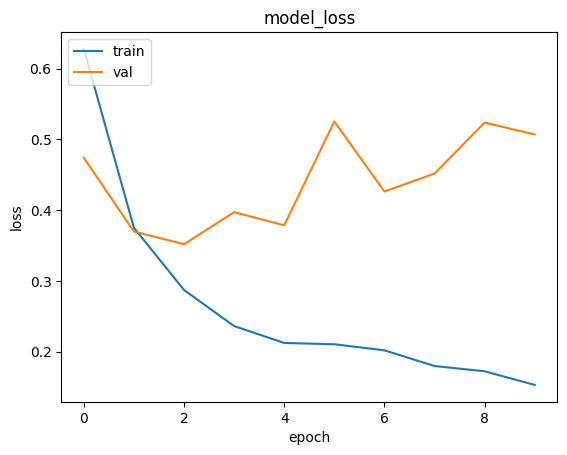

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model_loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

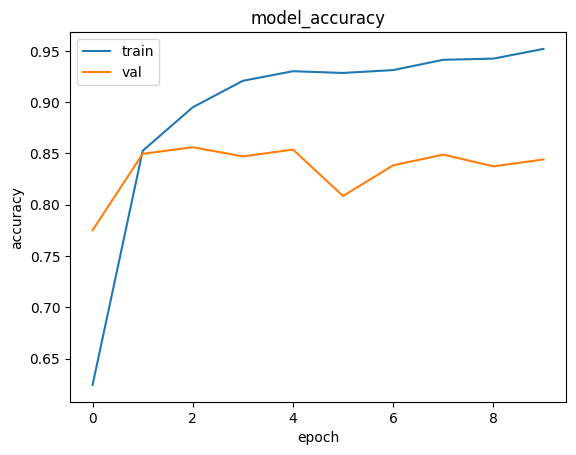

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])

plt.title('model_accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

## Evaluation

In [ ]:
test_dataset=test_data.map(vectorizer)
test_dataset=test_dataset.batch(batch_size)
model.evaluate(train_dataset)

391/391 ━━━━━━━━━━━━━━━━━━━━ 8s 21ms/step - accuracy: 0.9671 - loss: 0.1131


[0.11015447229146957, 0.9674400091171265]

# GRU (MultiLayer and Bidirectional)

In [ ]:
embedding_dim = 64

model=tf.keras.models.Sequential([
    Input(shape=(sequence_length,)),
    Embedding(vocab_size,embedding_dim),

    Bidirectional(GRU(64,return_sequences=True)),    # return_sequences=True, as we have 2 layered network so we want to pass all the outputs of the 1st layer to the 2nd layer
    Bidirectional(GRU(32)),      # 2nd layer

    Dense(64, activation='relu'),
    Dropout(0.5),
    Dense(1,activation='sigmoid'),
])
model.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_3 (Embedding)         │ (None, 250, 64)        │       640,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_4 (Bidirectional) │ (None, 250, 128)       │        49,920 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_5 (Bidirectional) │ (None, 64)             │        31,104 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 725,249 (2.77 MB)

 Trainable params: 725,249 (2.77 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
checkpoint_filepath = '/content/drive/MyDrive/nlp/sentiment_analysis/gru.h5'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

## Compiling

In [ ]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(1e-4),
              metrics=['accuracy'])

In [ ]:
history=model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=10,
    callbacks=[model_checkpoint_callback])

Epoch 1/10


KeyboardInterrupt: 

## Plots

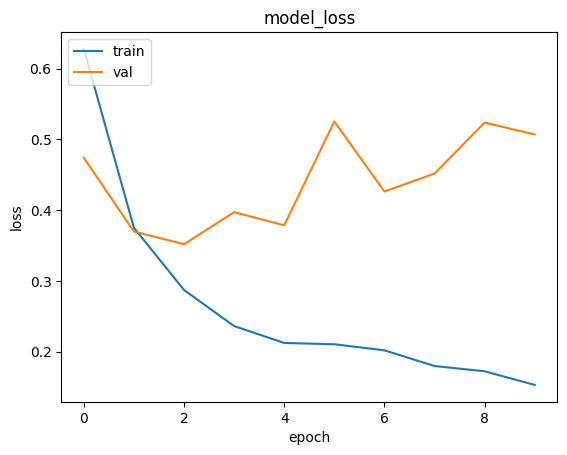

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model_loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

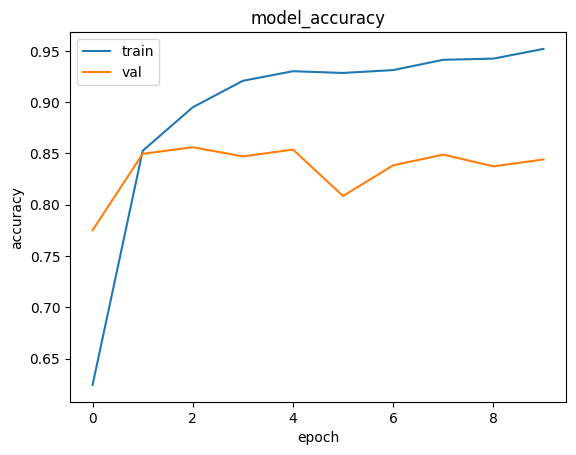

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])

plt.title('model_accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

## Evaluation

In [ ]:
test_dataset=test_data.map(vectorizer)
test_dataset=test_dataset.batch(batch_size)
model.evaluate(train_dataset)

ValueError: You must call `compile()` before using the model.

# **`1D Convolution (Conv1D)`**

### **`What is Conv1D?`**

- Conv1D applies a sliding **filter/kernel** along **one dimension** (e.g., time, sequence, or words).
- Each filter detects local patterns in the sequence (like *n-grams* in text).

### **`Conv1D Operation`**

`Input sequence:` $x = [x_1, x_2, ..., x_T]$  
`Filter (kernel)` $w = [w_1, w_2, ..., w_k]$ of size $k$  

At position $t$, the convolution is:

$$
y_t = \sum_{i=1}^k w_i \cdot x_{t+i-1}
$$

- The filter slides over the sequence → produces **feature maps**.
- Multiple filters learn different patterns.

### **`Output Dimension Formula`**

If:
- Input length = $L$
- Kernel size = $K$
- Stride = $S$
- Padding = $P$ (number of zeros added on each side)

Then output length is:

$$
\text{Output Length} = \left\lfloor \frac{L + 2P - K}{S} \right\rfloor + 1
$$

### **`Example`**

Suppose:
- Input length $L = 10$
- Kernel size $K = 3$
- Stride $S = 1$
- Padding $P = 0$

Then:

$$
\text{Output Length} = \frac{10 + 0 - 3}{1} + 1 = 8
$$


### **`Why Conv1D for NLP?`**
- Captures **local dependencies** (like "not good" → negative sentiment).
- More parallelizable than RNNs.
- Often used in **text classification, sentiment analysis, keyword spotting**.



In [ ]:
embedding_dim = 64

model=tf.keras.models.Sequential([
    Input(shape=(sequence_length,)),
    Embedding(vocab_size,embedding_dim),  #vocab_size 10000, embedding_dim = 64 ----> 10,000*64 = 640,000

    Conv1D(32, 3, activation='relu'),   #((250 +2*0 - 3)/1) + 1 = 248 ----> (248, 32)---> 32 is the number of filters applied
                                        # (kernel_size * input_channel * filters) + bias (filters) ----> (3 * 64 * 32) + 32 ---->  6,176
    Flatten(),                          # 248 * 32 = 7936

    Dense(64, activation='relu'),       # (7936 * 64) + 64 (bias)
    Dropout(0.5),
    Dense(1,activation='sigmoid'),
])
model.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_4 (Embedding)         │ (None, 250, 64)        │       640,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d (Conv1D)                 │ (None, 248, 32)        │         6,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 7936)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 64)             │       507,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,154,209 (4.40 MB)

 Trainable params: 1,154,209 (4.40 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
checkpoint_filepath = '/content/drive/MyDrive/nlp/sentiment_analysis/con1d.h5'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

## Compiling

In [ ]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(1e-4),
              metrics=['accuracy'])

In [ ]:
history=model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=10,
    callbacks=[model_checkpoint_callback])

## Plots

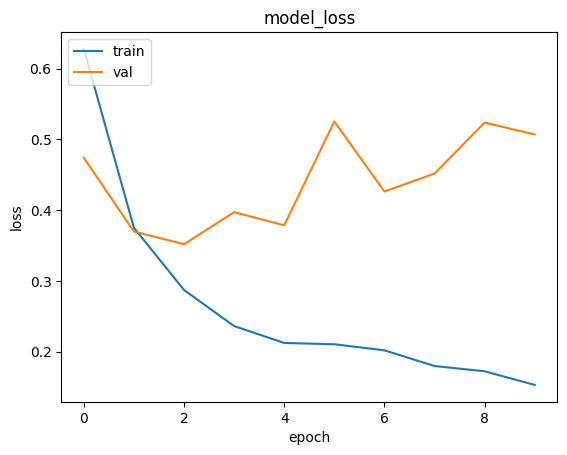

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model_loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

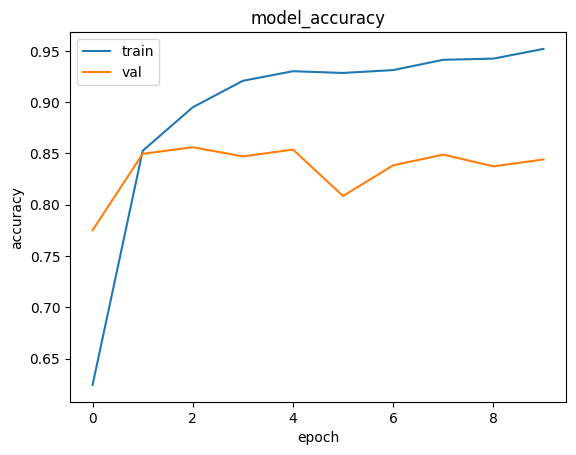

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])

plt.title('model_accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

## Evaluation

In [ ]:
test_dataset=test_data.map(vectorizer)
test_dataset=test_dataset.batch(batch_size)
model.evaluate(train_dataset)

ValueError: You must call `compile()` before using the model.

## Testing

In [ ]:

sentence = "I was there to watch this movie, at start it was exciting but as it proceed it became boring, the storyline was too lame, too badly written and badly acted by the actor."

# Vectorize (convert words to integers + pad to length=250)
vectorized_sentence = vectorization([sentence])  # shape: (1, 250)

print("Vectorized:", vectorized_sentence.numpy())

# Predict
prediction = model.predict(vectorized_sentence)

print("Raw Prediction:", prediction)

# result
if prediction[0][0] > 0.5:
    print("Positive Review (confidence:", prediction[0][0], ")")    # confidence is the probability of the positive class, 0.0046 → less than 0.5
else:
    print("Negative Review (confidence:", prediction[0][0], ")")


Vectorized: [[  11   13   48    6  103   10   17   30  366    9   13 1121   18   14
     9 7870    9  831  354    2  737   13   99  830   99  908  423    3
   908 1008   32    2  286    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0 

In [ ]:
reviews = [
    "The movie was absolutely fantastic, loved every bit of it!",
    "Terrible plot and bad acting, waste of time."
]

vec_reviews = vectorization(reviews)
preds = model.predict(vec_reviews)

for review, p in zip(reviews, preds):
    label = "Positive" if p[0] > 0.5 else "Negative"
    print(f"Review: {review}\nPrediction: {label} (confidence: {p[0]:.4f})\n")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step
Review: The movie was absolutely fantastic, loved every bit of it!
Prediction: Negative (confidence: 0.4973)

Review: Terrible plot and bad acting, waste of time.
Prediction: Negative (confidence: 0.4980)



## Load and Test

In [ ]:
# LOAD the models in this path /content/drive/MyDrive/nlp/sentiment_analysis
from keras.models import load_model
model_con1d = load_model('/content/drive/MyDrive/nlp/sentiment_analysis/1. con1d.h5')
model_gru = load_model('/content/drive/MyDrive/nlp/sentiment_analysis/1. gru.h5')
model_lstm = load_model('/content/drive/MyDrive/nlp/sentiment_analysis/1. rnn.h5')


In [ ]:
test_dataset=test_data.map(vectorizer)
test_dataset=test_dataset.batch(batch_size)
model_con1d.evaluate(train_dataset)

391/391 ━━━━━━━━━━━━━━━━━━━━ 7s 15ms/step - accuracy: 0.9307 - loss: 0.1897


[0.18256013095378876, 0.9358800053596497]

In [ ]:
model_gru.evaluate(train_dataset)

391/391 ━━━━━━━━━━━━━━━━━━━━ 9s 21ms/step - accuracy: 0.9148 - loss: 0.2190


[0.20594927668571472, 0.9203600287437439]

In [ ]:
model_lstm.evaluate(train_dataset)

391/391 ━━━━━━━━━━━━━━━━━━━━ 9s 20ms/step - accuracy: 0.9195 - loss: 0.2312


[0.2177133858203888, 0.9261199831962585]

In [ ]:
reviews = [
    "That movie was just awesome specially the character of Hans Landa who can speak 4 languages and the acting was fabulous I suggest everyone watch it.",
    "A milestone perfect in every single way cast history action thrill fights rise of a bastard son and a woman whose father lost his throne regain that again."
]

# reviews = ["this movie looks very interesting, i love the fact that the actors do a great job in showing how people lived in the 18th century, which wasn't very good at all. But atleast this movie recreates this scenes! ",
#             "very good start, but movie started becoming interesting at some point and fortunately at some point it started becoming much more fun, though there was too much background noise, so in all i liked this movie "
#             ]


vec_reviews = vectorization(reviews)
preds = model_con1d.predict(vec_reviews)

for review, p in zip(reviews, preds):
    label = "Positive" if p[0] > 0.5 else "Negative"
    print(f"Review: {review}\nPrediction: {label} (confidence: {p[0]:.4f})\n")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Review: That movie was just awesome specially the character of Hans Landa who can speak 4 languages and the acting was fabulous I suggest everyone watch it.
Prediction: Positive (confidence: 0.8426)

Review: A milestone perfect in every single way cast history action thrill fights rise of a bastard son and a woman whose father lost his throne regain that again.
Prediction: Positive (confidence: 0.9001)



In [ ]:
preds = model_gru.predict(vec_reviews)

for review, p in zip(reviews, preds):
    label = "Positive" if p[0] > 0.5 else "Negative"
    print(f"Review: {review}\nPrediction: {label} (confidence: {p[0]:.4f})\n")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Review: That movie was just awesome specially the character of Hans Landa who can speak 4 languages and the acting was fabulous I suggest everyone watch it.
Prediction: Positive (confidence: 0.9588)

Review: A milestone perfect in every single way cast history action thrill fights rise of a bastard son and a woman whose father lost his throne regain that again.
Prediction: Positive (confidence: 0.9367)



In [ ]:
preds = model_lstm.predict(vec_reviews)

for review, p in zip(reviews, preds):
    label = "Positive" if p[0] > 0.5 else "Negative"
    print(f"Review: {review}\nPrediction: {label} (confidence: {p[0]:.4f})\n")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
Review: That movie was just awesome specially the character of Hans Landa who can speak 4 languages and the acting was fabulous I suggest everyone watch it.
Prediction: Positive (confidence: 0.8273)

Review: A milestone perfect in every single way cast history action thrill fights rise of a bastard son and a woman whose father lost his throne regain that again.
Prediction: Positive (confidence: 0.8002)



# Understanding Word2Vector

```python
Text -----> OneHot vectors (Sparse - more 0s) ----EmbeddingLayer---
----> Embedding Vectors (Dense vectors - less zeros) -----> RNN
```
- In Embedding vector space, the words with similar meaning fall near each other and vice versa. which helps RNN to learn imp information.
- Word2Vector works on predict next word in sequence mechanism or CBOW (several inputs, single output) method which works like fill in the blanks, sometimes middle are missing and model predicts them or SKIPgram (1 input, 1 output) predicts neighboring words in the sliding window like say sliding window is on "Crow is a very ineteresting black bird." input could be black and output could be any word in the window here.
- Inputs -----> Embedding vectors ----> Simple model Trained on a Simple Problem.
- Embedding Vectors/Matrix of Simple Model used with Complex model


```python
Text -----> One-Hot vectors (Sparse: mostly 0s)
     -----> Embedding Layer
     -----> Dense Vectors (meaningful, fewer zeros)
     -----> RNN / LSTM / Transformer
```

* In **embedding space**, words with similar meanings lie close to each other.
* Word2Vec learns embeddings by solving a **self-supervised task**:

  * **CBOW**: predict the center word from surrounding context.
  * **Skip-gram**: predict surrounding context words from the center word.

## 1. **`From One-Hot to Embedding`**

* **`One-hot vector`** for a word (vocab size = $V$):

$$
x_w = [0,0,0,\dots,1,\dots,0] \quad \in \mathbb{R}^V
$$

* `Embedding matrix:`

$$
W \in \mathbb{R}^{V \times d}
$$

* `Word embedding:`

$$
v_w = x_w W \quad \in \mathbb{R}^d
$$

## 2. **`CBOW (Continuous Bag of Words)`**

* Input = context words (window size = $m$)
* Output = predict the **center word**

`Example:`

> - `"Crow is a very interesting black bird"`
> - Window = 2
> - Context = \[“Crow”, “is”, “very”, “interesting”] → predict `"a"`

**Probability (softmax):**

$$
P(w_t | context) = \frac{e^{v'_{w_t} \cdot h}}{\sum_{w=1}^{V} e^{v'_{w} \cdot h}}
$$

where

* $h = \frac{1}{2m} \sum v_{context}$ (average context embeddings)
* $v_w$ = input embedding of word $w$
* $v'_w$ = output embedding of word $w$

## 3. **`Skip-gram`**

* Input = center word
* Output = predict **surrounding context words**

Example (window size = 2):
- Center = `"black"` → neighbors = {“interesting”, “bird”}

**`Formula:`**

$$
P(context | w_t) = \prod_{-m \leq j \leq m, j \neq 0} P(w_{t+j} | w_t)
$$

`with`

$$
P(w_o | w_t) = \frac{e^{v'_{w_o} \cdot v_{w_t}}}{\sum_{w=1}^V e^{v'_{w} \cdot v_{w_t}}}
$$


## 4. **`Negative Sampling`**

* Instead of summing over all vocab (huge cost), sample only a few **negative examples**.
* This speeds up training and produces meaningful embeddings.

## **`Using Word2Vec Embeddings`**
Train Word2Vec separately (simple model).

`After training:`
* You get an **embedding matrix** $W \in \mathbb{R}^{V \times d}$.
* Each row = dense vector representation of a word.

`Properties:`
* Captures semantic meaning (e.g., **king - man + woman ≈ queen**).
* Use learned embedding matrix as weights in Embedding layer of a **bigger/complex models** model (RNN, LSTM, Transformer).

`Usage in downstream models:`
* Initialize embedding layer with pre-trained Word2Vec weights.
* Options:
  * **Freeze embeddings** (keep fixed).
  * **Fine-tune embeddings** (let the bigger model adjust them for the new task).

**`Summary:`**
* Word2Vec solves a **simple prediction task** (CBOW or Skip-gram).
* Learned embeddings are **transferred** to complex tasks (sentiment analysis, translation, etc.).



In [ ]:
from IPython.display import IFrame

IFrame(
  src="https://drive.google.com/file/d/12gHQeENX9_aj9eI_CUIfgmpYedP7_pnA/preview",
  width=1200,
  height=600
)

# Integrating Pretrained Word2vector Embeddings ([Gensim](https://radimrehurek.com/gensim/auto_examples/index.html#documentation))

In [ ]:
vocab_size = 10000
sequence_length = 250
embedding_dim = 300

In [ ]:
# Uninstall and reinstall numpy and gensim
!pip uninstall -y numpy gensim
!pip install numpy gensim --upgrade

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.6/26.6 MB 87.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 112.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.2/38.2 MB 17.2 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tsfresh 0.21.1 requires scipy>=1.14.0; python_version >= "3.10", but you have scipy 1.13.1 which is incompatible.
opencv-contrib-python 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
opencv-python 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have nu

In [ ]:
import gensim.downloader as api

In [ ]:
word2vec = api.load('word2vec-google-news-300')   # trained on google news data with 300 Embedding dim

In [ ]:
word2vec.vectors.shape      # (3000000, 300) (vocab_size, embedding_dim)

(3000000, 300)

In [ ]:
# 3 Million different words in vocabulary
word2vec.key_to_index     # .index_to_key .get_vecattr(key, attr) and .set_vecattr(key, attr, new_val) instead.

{'</s>': 0,
 'in': 1,
 'for': 2,
 'that': 3,
 'is': 4,
 'on': 5,
 '##': 6,
 'The': 7,
 'with': 8,
 'said': 9,
 'was': 10,
 'the': 11,
 'at': 12,
 'not': 13,
 'as': 14,
 'it': 15,
 'be': 16,
 'from': 17,
 'by': 18,
 'are': 19,
 'I': 20,
 'have': 21,
 'he': 22,
 'will': 23,
 'has': 24,
 '####': 25,
 'his': 26,
 'an': 27,
 'this': 28,
 'or': 29,
 'their': 30,
 'who': 31,
 'they': 32,
 'but': 33,
 '$': 34,
 'had': 35,
 'year': 36,
 'were': 37,
 'we': 38,
 'more': 39,
 '###': 40,
 'up': 41,
 'been': 42,
 'you': 43,
 'its': 44,
 'one': 45,
 'about': 46,
 'would': 47,
 'which': 48,
 'out': 49,
 'can': 50,
 'It': 51,
 'all': 52,
 'also': 53,
 'two': 54,
 'after': 55,
 'first': 56,
 'He': 57,
 'do': 58,
 'time': 59,
 'than': 60,
 'when': 61,
 'We': 62,
 'over': 63,
 'last': 64,
 'new': 65,
 'other': 66,
 'her': 67,
 'people': 68,
 'into': 69,
 'In': 70,
 'our': 71,
 'there': 72,
 'A': 73,
 'she': 74,
 'could': 75,
 'just': 76,
 'years': 77,
 'some': 78,
 'U.S.': 79,
 'three': 80,
 'million': 81

In [ ]:
word2vec["The"]     # outputs 300 dimensional vector
# print(len(word2vec["The"]))

array([-0.17285156,  0.27929688,  0.10693359, -0.15820312, -0.08447266,
        0.05908203,  0.04077148,  0.00254822,  0.25976562,  0.18066406,
        0.09765625, -0.08105469, -0.01049805,  0.09814453,  0.00060272,
        0.07080078, -0.015625  , -0.09521484, -0.08105469, -0.02868652,
       -0.03320312,  0.16503906,  0.03979492, -0.03710938,  0.04101562,
       -0.12695312, -0.12890625,  0.12353516,  0.04980469,  0.01257324,
        0.05786133, -0.00830078, -0.02832031, -0.03320312,  0.16113281,
        0.07519531, -0.25976562,  0.08935547,  0.13574219,  0.00460815,
       -0.04418945,  0.02319336, -0.10449219, -0.05151367,  0.08349609,
       -0.02050781, -0.02172852, -0.02734375,  0.16015625,  0.19042969,
       -0.0324707 ,  0.06787109,  0.10302734, -0.25390625,  0.00634766,
        0.20507812,  0.02111816, -0.21679688, -0.02441406,  0.17089844,
       -0.21875   ,  0.10009766, -0.15527344, -0.12597656, -0.03833008,
       -0.05419922,  0.19238281,  0.21777344,  0.12109375, -0.02

In [ ]:
# Similar words are mapped closer to each other
word2vec.most_similar("Man")

[('Woman', 0.6939345002174377),
 ('Boy', 0.5896925330162048),
 ('Girl', 0.584598958492279),
 ('Suspect', 0.5577560067176819),
 ('Couple', 0.5528685450553894),
 ('man', 0.5316051840782166),
 ('Robber', 0.5315312743186951),
 ('Teenager', 0.5161930322647095),
 ('depicts_Michelangelo_Creation', 0.5148172378540039),
 ('Policeman', 0.5136396884918213)]

In [ ]:
def first_caps(word):
  return word[0].upper()+word[1:]   # First letter upper and rest same

print(vectorization.get_vocabulary()[2])

first_caps(vectorization.get_vocabulary()[2])

the


'The'

## Getting the Pretrained Embeddings
- Our vocabulary size was 10,000 only but this model has vocab size of 3 Million
- So we'll get the embeddings for each word in our 10,000 words, from this model of 3 Million vocab size.

In [ ]:
pretrained_embeddings = []


for i in range(len(vectorization.get_vocabulary())):      # our vocabulary
  try:
    pretrained_embeddings.append(word2vec[vectorization.get_vocabulary()[i]])
  except:
    print(vectorization.get_vocabulary()[i])


    # Some words are not in the word2vec like 'and' is not in the vocab but 'And' is present. So we make those to Upper case
    try:
      pretrained_embeddings.append(word2vec[first_caps(vectorization.get_vocabulary()[i])])
      print('to upper')
    except:
      print('no solution')
      pretrained_embeddings.append(random.normal(loc=0, scale=1, size=(embedding_dim))) #reloaded_word_vectors[vectorize_layer.get_vocabulary()[i]])


    if i%1000 == 0:
      print('i is ===', i)

# pretrained_embeddings = np.array(pretrained_embeddings)


no solution
i is === 0
[UNK]
no solution
and
to upper
a
to upper
of
to upper
to
to upper
doesnt
no solution
didnt
no solution
isnt
no solution
wasnt
no solution
10
no solution
80s
no solution
20
no solution
70s
no solution
15
no solution
12
no solution
30
no solution
humour
to upper
100
no solution
hasnt
no solution
90
no solution
shouldnt
no solution
favourite
to upper
theatre
to upper
60s
no solution
40
no solution
lowbudget
no solution
tarzan
to upper
50
no solution
90s
no solution
1950s
no solution
keaton
to upper
welles
to upper
50s
no solution
1010
no solution
11
no solution
1970s
no solution
overthetop
no solution
sinatra
to upper
columbo
to upper
1980s
no solution
25
no solution
1930s
no solution
14
no solution
13
no solution
bmovie
no solution
aint
to upper
pacino
to upper
moviethe
no solution
writerdirector
no solution
itthe
no solution
lugosi
to upper
hitchcock
to upper
810
no solution
30s
no solution
filmthe
no solution
2006
no solution
1960s
no solution
2000
no solution
1

In [ ]:
# Example Usage with i = 7, some keys in our vocabulary are not present in the word2vec like 3, 4, 5
print(vectorization.get_vocabulary()[7])
print("===========================")

word2vec[vectorization.get_vocabulary()[7]]

is


array([ 0.00704956, -0.07324219,  0.171875  ,  0.02258301, -0.1328125 ,
        0.19824219,  0.11279297, -0.10791016,  0.07177734,  0.02087402,
       -0.12304688, -0.05908203,  0.10107422,  0.01074219,  0.14355469,
        0.25976562, -0.03637695,  0.18554688, -0.07861328, -0.02270508,
       -0.12060547,  0.17773438,  0.04956055,  0.01721191,  0.07958984,
       -0.0456543 , -0.18847656,  0.18945312, -0.02319336,  0.06298828,
        0.09765625, -0.01904297, -0.07910156,  0.15234375,  0.17382812,
        0.1015625 , -0.16308594,  0.11474609,  0.10058594, -0.09277344,
        0.109375  ,  0.05883789, -0.02160645,  0.06347656,  0.04199219,
       -0.0088501 ,  0.03222656,  0.10644531,  0.06445312, -0.11865234,
        0.03051758,  0.06689453,  0.12207031, -0.08300781,  0.171875  ,
        0.07861328,  0.09521484, -0.00778198,  0.02319336,  0.0234375 ,
       -0.0168457 ,  0.15527344, -0.10986328, -0.17675781, -0.11621094,
        0.0234375 , -0.01062012,  0.05273438, -0.13378906,  0.07

### Save pretrained Embedding so don't have to Download them Again

In [ ]:
pretrained_embeddings_array = np.array(pretrained_embeddings)

print(pretrained_embeddings_array.shape)

(10000, 300)


In [ ]:
np.save('/content/drive/MyDrive/nlp/sentiment_analysis/pretrained_embeddings',pretrained_embeddings_array)

NameError: name 'pretrained_embeddings_array' is not defined

In [ ]:
pretrained_embeddings_array = np.load('/content/drive/MyDrive/nlp/sentiment_analysis/pretrained_embeddings.npy')

pretrained_embeddings_array.shape

(10000, 300)

## Modelling

In [ ]:
embedding_dim = 300
model=tf.keras.models.Sequential([
    Input(shape = (sequence_length,)),
    Embedding(
        vocab_size,
        embedding_dim,

        embeddings_initializer = tf.keras.initializers.Constant(pretrained_embeddings_array),     # initializes pretrained embedding array (10,000 by 300 = 3 Million)
        trainable = True,
    ),

    Conv1D(32, 3, activation = 'relu',),
    Flatten(),
    Dense(32, activation = 'relu'),
    Dropout(0.5),
    Dense(1,activation = 'sigmoid'),
])
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding (Embedding)           │ (None, 250, 300)       │     3,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d (Conv1D)                 │ (None, 248, 32)        │        28,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 7936)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 32)             │       253,984 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,282,849 (12.52 MB)

 Trainable params: 3,282,849 (12.52 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
checkpoint_filepath = '/content/drive/MyDrive/nlp/sentiment_analysis/conv_1d_word2vec.h5'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath = checkpoint_filepath,
    monitor = 'val_accuracy',
    mode = 'max',
    save_best_only = True)

In [ ]:
model.compile(loss = tf.keras.losses.BinaryCrossentropy(),
              optimizer = tf.keras.optimizers.Adam(1e-4),
              metrics = ['accuracy'])

In [ ]:
history = model.fit(
    train_dataset,
    validation_data = val_dataset,
    epochs=10,
    callbacks=[model_checkpoint_callback])

Epoch 1/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - accuracy: 0.5057 - loss: 0.7000

391/391 ━━━━━━━━━━━━━━━━━━━━ 33s 63ms/step - accuracy: 0.5057 - loss: 0.7000 - val_accuracy: 0.5110 - val_loss: 0.6926
Epoch 2/10
389/391 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.5238 - loss: 0.6907

391/391 ━━━━━━━━━━━━━━━━━━━━ 19s 47ms/step - accuracy: 0.5238 - loss: 0.6907 - val_accuracy: 0.5280 - val_loss: 0.6904
Epoch 3/10
390/391 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.5643 - loss: 0.6772

391/391 ━━━━━━━━━━━━━━━━━━━━ 16s 40ms/step - accuracy: 0.5645 - loss: 0.6771 - val_accuracy: 0.7658 - val_loss: 0.5387
Epoch 4/10
388/391 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.7968 - loss: 0.4659

391/391 ━━━━━━━━━━━━━━━━━━━━ 14s 36ms/step - accuracy: 0.7971 - loss: 0.4654 - val_accuracy: 0.8474 - val_loss: 0.3602
Epoch 5/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - accuracy: 0.8731 - loss: 0.3192

391/391 ━━━━━━━━━━━━━━━━━━━━ 24s 62ms/step - accuracy: 0.8731 - loss: 0.3191 - val_accuracy: 0.8578 - val_loss: 0.3300
Epoch 6/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.8992 - loss: 0.2637

391/391 ━━━━━━━━━━━━━━━━━━━━ 16s 42ms/step - accuracy: 0.8992 - loss: 0.2637 - val_accuracy: 0.8642 - val_loss: 0.3221
Epoch 7/10
389/391 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - accuracy: 0.9171 - loss: 0.2218

391/391 ━━━━━━━━━━━━━━━━━━━━ 17s 44ms/step - accuracy: 0.9171 - loss: 0.2217 - val_accuracy: 0.8659 - val_loss: 0.3221
Epoch 8/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 9s 24ms/step - accuracy: 0.9336 - loss: 0.1891 - val_accuracy: 0.8659 - val_loss: 0.3277
Epoch 9/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - accuracy: 0.9471 - loss: 0.1587 - val_accuracy: 0.8647 - val_loss: 0.3400
Epoch 10/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - accuracy: 0.9582 - loss: 0.1370 - val_accuracy: 0.8610 - val_loss: 0.3641


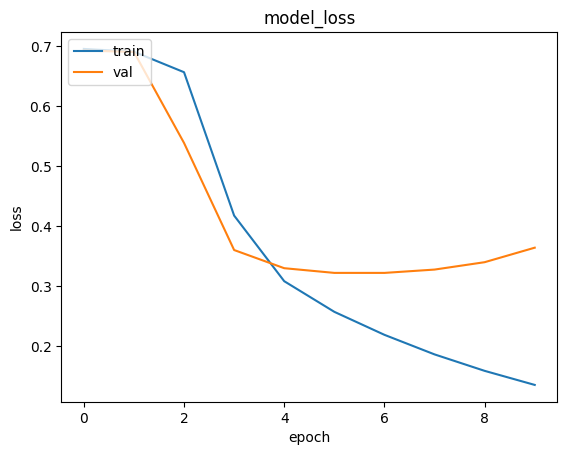

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model_loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

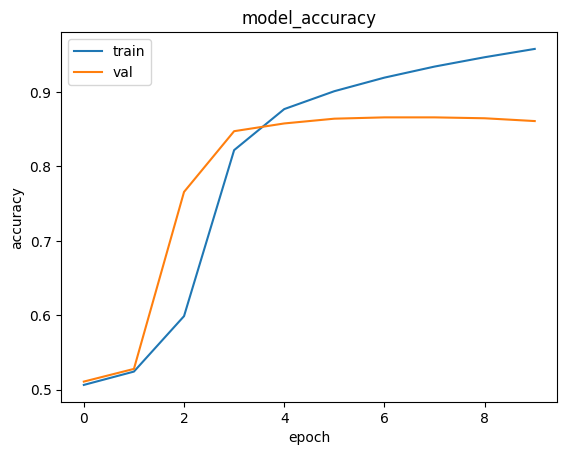

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])

plt.title('model_accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

## Evaluating

In [ ]:
model.load_weights(checkpoint_filepath)

In [ ]:
test_dataset=test_data.map(vectorizer)

test_dataset=test_dataset.batch(batch_size)
model.evaluate(test_dataset)

196/196 ━━━━━━━━━━━━━━━━━━━━ 6s 24ms/step - accuracy: 0.8638 - loss: 0.3208


[0.32412806153297424, 0.8631200194358826]

In [ ]:
# test_pos="this movie looks very interesting, i love the fact that the actors do a great job in showing how people lived in the 18th century, which wasn't very good at all. But atleast this movie recreates this scenes! "
# test_neg="very good start, but movie started becoming boring at some point and unfortunately i didn't feel like this was properly produced as there was too much background noise, and the actors didn't look motivated at all "

In [ ]:
test_data=tf.data.Dataset.from_tensor_slices([["this movie looks very interesting, i love the fact that the actors do a great job in showing how people lived in the 18th century, which wasn't very good at all. But atleast this movie recreates this scenes! "],
                                              ["very good start, but movie started becoming interesting at some point and fortunately at some point it started becoming much more fun, though there was too much background noise, so in all i liked this movie "],])


In [ ]:
def vectorizer_test(review):
    return vectorization(review)
test_dataset=test_data.map(vectorizer_test)

In [ ]:
preds = model.predict(test_dataset)

for review, p in zip(test_data, preds):
    label = "Positive" if p[0] > 0.5 else "Negative"
    print(f"Review: {review}\nPrediction: {label} (confidence: {p[0]:.4f})\n")


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step 
Review: [b"this movie looks very interesting, i love the fact that the actors do a great job in showing how people lived in the 18th century, which wasn't very good at all. But atleast this movie recreates this scenes! "]
Prediction: Positive (confidence: 0.6784)

Review: [b'very good start, but movie started becoming interesting at some point and fortunately at some point it started becoming much more fun, though there was too much background noise, so in all i liked this movie ']
Prediction: Positive (confidence: 0.6933)



## Inference Ready Testing
- Making vectorization a part of Model arhitecture so It can be deployed.

In [ ]:
from keras.layers import Input
from keras.models import Model

In [ ]:
inputs = Input(shape=(1,), dtype="string")

vectorized_inputs = vectorization(inputs)

outputs = model(vectorized_inputs)    # model we trained earlier, takes previous layer as input as it is a Functional model now

inference_ready_model = tf.keras.Model(inputs, outputs)

inference_ready_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 1)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ text_vectorization              │ (None, 250)            │             0 │
│ (TextVectorization)             │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential (Sequential)         │ (None, 1)              │     3,282,849 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,282,849 (12.52 MB)

 Trainable params: 3,282,849 (12.52 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
inference_ready_model.predict(tf.constant(["this movie looks very interesting, i love the fact that the actors do a great job in showing how people lived in the 18th century, which wasn't very good at all. But atleast this movie recreates this scenes! ",
                               "very good start, but movie started becoming interesting at some point and fortunately at some point it started becoming much more fun, though there was too much background noise, so in all i liked this movie "]))

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


array([[0.67837936],
       [0.69334376]], dtype=float32)

# Visualizing Embeddings in Tensorboard

In [ ]:
embedding_dim=300
model=tf.keras.models.Sequential([
    Input(shape=(sequence_length,)),
    Embedding(vocab_size,embedding_dim),

    Conv1D(32, 3, activation='relu',),
    Flatten(),
    Dense(32, activation='relu'),
    Dropout(0.5),
    Dense(1,activation='sigmoid'),
])
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_1 (Embedding)         │ (None, 250, 300)       │     3,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_1 (Conv1D)               │ (None, 248, 32)        │        28,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 7936)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 32)             │       253,984 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,282,849 (12.52 MB)

 Trainable params: 3,282,849 (12.52 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(1e-4),
              metrics=['accuracy'])

In [ ]:
log_dir='logs/imdb/fit/'+datetime.datetime.now().strftime("%Y%m%d-%H%M%S")+'/'

In [ ]:
tensorboard_callback=tf.keras.callbacks.TensorBoard(log_dir,histogram_freq=1)

In [ ]:
history=model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=10,
    callbacks=[tensorboard_callback])

Epoch 1/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 10s 26ms/step - accuracy: 0.7667 - loss: 0.5168 - val_accuracy: 0.8610 - val_loss: 0.3300
Epoch 2/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - accuracy: 0.8921 - loss: 0.2722 - val_accuracy: 0.8679 - val_loss: 0.3135
Epoch 3/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - accuracy: 0.9226 - loss: 0.2130 - val_accuracy: 0.8653 - val_loss: 0.3319
Epoch 4/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 19s 27ms/step - accuracy: 0.9436 - loss: 0.1708 - val_accuracy: 0.8516 - val_loss: 0.3810
Epoch 5/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 10s 26ms/step - accuracy: 0.9518 - loss: 0.1452 - val_accuracy: 0.8501 - val_loss: 0.4002
Epoch 6/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 10s 26ms/step - accuracy: 0.9539 - loss: 0.1344 - val_accuracy: 0.8519 - val_loss: 0.3813
Epoch 7/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - accuracy: 0.9653 - loss: 0.1103 - val_accuracy: 0.8486 - val_loss: 0.4041
Epoch 8/10
391/391 ━━━━━━━━━━━━━━━━━━━━ 10s 25ms/step - accuracy: 0.9744 - loss: 0.0870 - 

In [ ]:
with open(os.path.join(log_dir,'metadata.tsv'),"w",encoding="utf-8") as f:
  for i in range(vocab_size):
    f.write("{} {}\n".format(i,vectorization.get_vocabulary()[i]))    # stores every word for index i in metadata.tsv file

In [ ]:
embedding_weights=tf.Variable(model.layers[0].get_weights()[0])
print(embedding_weights.shape)

(10000, 300)


In [ ]:
checkpoint=tf.train.Checkpoint(embedding=embedding_weights)
checkpoint.save(os.path.join(log_dir,"embedding.ckpt"))

config=projector.ProjectorConfig()
embedding=config.embeddings.add()

In [ ]:
embedding.metadata_path='metadata.tsv'
projector.visualize_embeddings(log_dir,config)

## Load the tensorboard
- after its screen appears Select `INACTIVE` dropdown and click on `PROJECTOR` to see the `vocabulary in 3D`, then on `left side` under DATA, `click on load` and `upload metadata.tsv` file to it then you can search any word in right pannel.

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir logs/imdb/fit/

Reusing TensorBoard on port 6006 (pid 8559), started 0:46:29 ago. (Use '!kill 8559' to kill it.)

<IPython.core.display.Javascript object>